# Data presentation

In [2]:
import pandas as pd
import os

os.chdir("..")

In [3]:
data_test = pd.read_csv("Dataset/geolifeclef-2024/GLC24_PA_metadata_test.csv")

In [4]:
data_test.head()

,lon,lat,year,geoUncertaintyInM,areaInM2,region,country,surveyId
0,10.033550,57.12081,2019,10.0,707.0,CONTINENTAL,Denmark,642
1,7.333000,46.22997,2019,NaN,10.0,ALPINE,Switzerland,1792
2,1.843658,42.58006,2018,0.0,-inf,ALPINE,France,3256
3,11.720090,46.26149,2021,10.0,35.0,ALPINE,Italy,3855
4,9.361870,55.90245,2017,10.0,79.0,CONTINENTAL,Denmark,4889


In [5]:
data_test.isna().any

<bound method DataFrame.any of         lon    lat   year  geoUncertaintyInM  areaInM2  region  country  \
0     False  False  False              False     False   False    False   
1     False  False  False               True     False   False    False   
2     False  False  False              False     False   False    False   
3     False  False  False              False     False   False    False   
4     False  False  False              False     False   False    False   
...     ...    ...    ...                ...       ...     ...      ...   
4711  False  False  False              False     False   False    False   
4712  False  False  False              False     False   False    False   
4713  False  False  False              False     False   False    False   
4714  False  False  False              False     False   False    False   
4715  False  False  False              False     False   False    False   

      surveyId  
0        False  
1        False  
2        False  


In [6]:
data_test.dropna(inplace=True)

In [7]:
data_train = pd.read_csv("Dataset/geolifeclef-2024/GLC24_PA_metadata_train.csv")


In [8]:
data_train.sample(3)

,lon,lat,year,geoUncertaintyInM,areaInM2,region,country,speciesId,surveyId
696020,5.762573,52.101347,2019,5.0,3.75,ATLANTIC,Netherlands,6903.0,1852742
1026966,2.493380,45.770600,2017,1.0,NaN,CONTINENTAL,France,6331.0,2730440
1451366,9.779140,57.350200,2017,10.0,79.00,CONTINENTAL,Denmark,10073.0,3837748


In [9]:
data_train.dtypes

lon                  float64
lat                  float64
year                   int64
geoUncertaintyInM    float64
areaInM2             float64
region                object
country               object
speciesId            float64
surveyId               int64
dtype: object

In [10]:
data_train.isna().any

<bound method DataFrame.any of            lon    lat   year  geoUncertaintyInM  areaInM2  region  country  \
0        False  False  False              False     False   False    False   
1        False  False  False              False     False   False    False   
2        False  False  False              False     False   False    False   
3        False  False  False              False     False   False    False   
4        False  False  False              False     False   False    False   
...        ...    ...    ...                ...       ...     ...      ...   
1483632  False  False  False              False     False   False    False   
1483633  False  False  False              False     False   False    False   
1483634  False  False  False              False     False   False    False   
1483635  False  False  False              False     False   False    False   
1483636  False  False  False              False     False   False    False   

         speciesId  surveyId  
0

In [11]:
data_train.dropna(inplace=True)

In [12]:
data_train = data_train.drop(["region","country","geoUncertaintyInM","areaInM2"],axis=1)
data_test = data_test.drop(["region","country","geoUncertaintyInM","areaInM2"],axis=1)

## VIEWING THE DATA

In [13]:
data_coord = data_train.loc[:, ["surveyId","lon", "lat"]].copy()

In [14]:
data_coord

,surveyId,lon,lat
0,212,3.099038,43.134956
1,212,3.099038,43.134956
2,212,3.099038,43.134956
3,212,3.099038,43.134956
4,212,3.099038,43.134956
...,...,...,...
1483632,3919655,9.913980,56.827580
1483633,3919655,9.913980,56.827580
1483634,3919655,9.913980,56.827580
1483635,3919655,9.913980,56.827580


In [15]:
data_coord.dropna(inplace=True)

<Axes: xlabel='lon', ylabel='lat'>

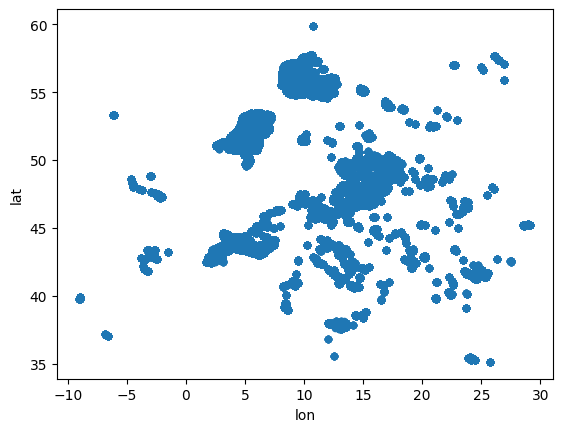

In [16]:
data_coord.plot.scatter('lon','lat')

In [17]:
mean_lon = data_coord["lon"].mean()
mean_lat = data_coord["lat"].mean()

In [18]:
import folium
from folium.plugins import FastMarkerCluster

# Create a map object centered at the mean location
map_obj = folium.Map(location=[mean_lat, mean_lon], tiles='cartodbpositron', zoom_start=5)

# Add FastMarkerCluster to the map
for idx in range(0,len(data_coord),100000):
    if (idx+100000 < len(data_coord)):
        markers_data = data_coord.iloc[idx:idx+100000]
    else:
        markers_data = data_coord.iloc[idx:len(data_coord)]
    map_obj.add_child(FastMarkerCluster(markers_data[['lat', 'lon']].values.tolist()))

# Display the map
map_obj

In [19]:
elevation_data = pd.read_csv('Dataset/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Elevation/GLC24-PA-train-elevation.csv')
elevation_data.dropna(inplace=True)

elevation_data

,surveyId,Elevation
0,212,47.0
1,222,6.0
2,243,10.0
3,324,116.0
4,333,84.0
...,...,...
88982,3919553,23.0
88983,3919592,138.0
88984,3919620,37.0
88985,3919640,131.0


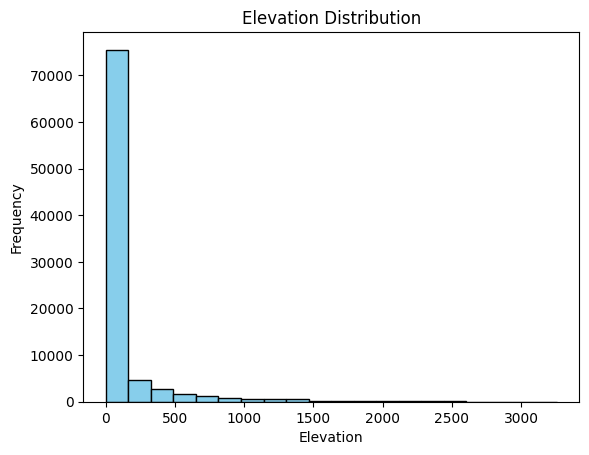

In [20]:
import matplotlib.pyplot as plt

plt.hist(elevation_data['Elevation'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Elevation')
plt.ylabel('Frequency')
plt.title('Elevation Distribution')
plt.show()

In [21]:
elevationgrid_data = elevation_data.merge(data_coord, on='surveyId', how='left')

latitude = elevationgrid_data['lat']
longitude = elevationgrid_data['lon']
elevation = elevationgrid_data['Elevation']

c:\Users\yashr\anaconda3\envs\geoenv\lib\site-packages\cartopy\io\__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


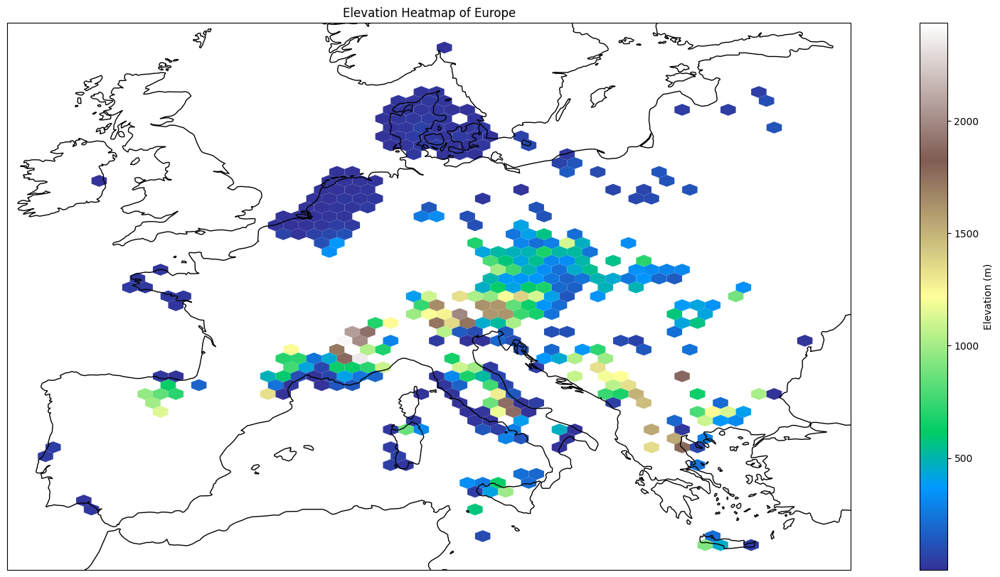

In [24]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

fig = plt.figure(figsize=(25, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Add a background map of Europe
ax.coastlines()

# Create a 2D hexagonal binning plot (heatmap)
hb = ax.hexbin(longitude, latitude, C=elevation, gridsize=50, cmap='terrain', edgecolors='none')

# Add a colorbar
cb = fig.colorbar(hb, ax=ax, orientation='vertical', label='Elevation (m)')


ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Elevation Heatmap of Europe')


plt.show()

In [26]:
landcover_data = pd.read_csv('Dataset/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/LandCover/GLC24-PA-train-landcover.csv')
landcover_data.dropna(inplace=True)

landcover_data

,surveyId,LandCover
0,212,8.0
1,222,12.0
2,243,5.0
3,324,14.0
4,333,14.0
...,...,...
88982,3919553,12.0
88983,3919592,1.0
88984,3919620,12.0
88985,3919640,1.0


In [27]:
landcovergrid_data = landcover_data.merge(data_coord, on='surveyId', how='left')


latitude = landcovergrid_data['lat']
longitude = landcovergrid_data['lon']
landcover = landcovergrid_data['LandCover']

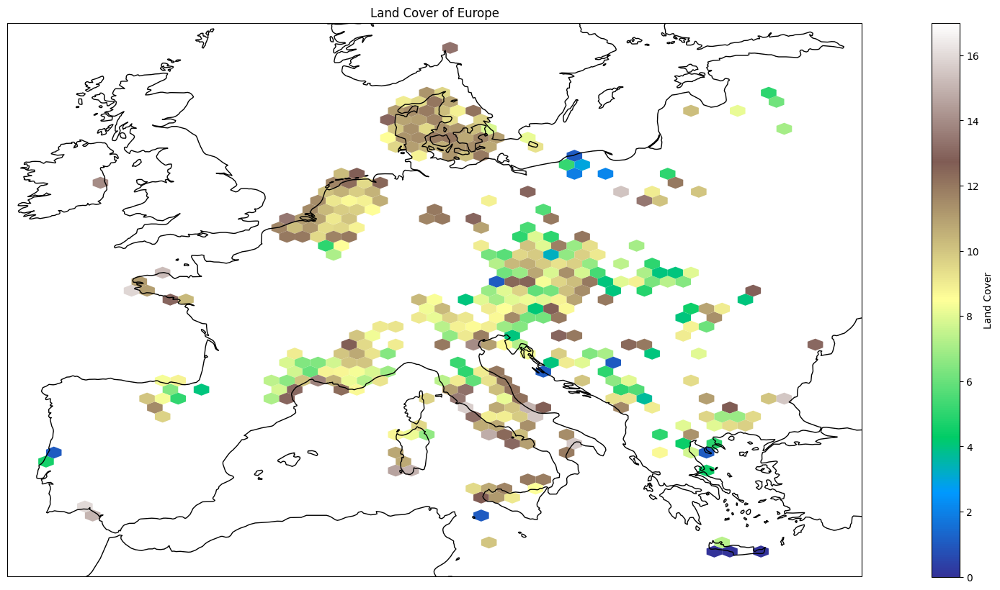

In [28]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

fig = plt.figure(figsize=(25, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Add a background map of Europe
ax.coastlines()

# Create a 2D hexagonal binning plot (heatmap)
hb = ax.hexbin(longitude, latitude, C=landcover, gridsize=50, cmap='terrain', edgecolors='none')

# Add a colorbar
cb = fig.colorbar(hb, ax=ax, orientation='vertical', label='Land Cover')


ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_title('Land Cover of Europe')


plt.show()

In [29]:
footprint_data = pd.read_csv('Dataset/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/Human Footprint/GLC24-PA-train-human_footprint.csv')
footprint_data.dropna(inplace=True)

footprint_data

,surveyId,HumanFootprint-Built1994,HumanFootprint-Built2009,HumanFootprint-croplands1992,HumanFootprint-croplands2005,HumanFootprint-Lights1994,HumanFootprint-Lights2009,HumanFootprint-NavWater1994,HumanFootprint-NavWater2009,HumanFootprint-Pasture1993,HumanFootprint-Pasture2009,HumanFootprint-Popdensity1990,HumanFootprint-Popdensity2010,HumanFootprint-Railways,HumanFootprint-Roads,HumanFootprint-HFP1993,HumanFootprint-HFP2009
0,212,0.0,0.0,7.0,7.00,6.0,6.0,0.0,0.0,0.0,0.0,6.0,7.0,0.0,0.0,20.0,21.0
1,222,0.0,0.0,3.5,7.00,1.0,1.0,0.0,0.0,0.0,0.0,7.0,7.0,4.0,2.0,10.0,17.0
2,243,0.0,0.0,7.0,0.00,4.0,2.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,0.0,15.0,6.0
3,324,0.0,0.0,0.0,7.00,0.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,0.0,4.0,9.0,15.0
4,333,0.0,0.0,7.0,7.00,1.0,4.0,0.0,0.0,0.0,0.0,5.0,5.0,0.0,0.0,13.0,16.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88982,3919553,0.0,0.0,7.0,7.00,1.0,0.0,0.0,0.0,0.0,0.0,5.0,5.0,0.0,1.0,14.0,13.0
88983,3919592,0.0,0.0,7.0,1.75,0.0,0.0,0.0,0.0,0.0,0.0,5.0,5.0,0.0,1.0,13.0,6.0
88984,3919620,0.0,0.0,7.0,0.00,2.0,1.0,0.0,0.0,0.0,0.0,5.0,5.0,4.0,0.0,14.0,6.0
88985,3919640,0.0,0.0,7.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0,0.0,0.0,11.0,4.0


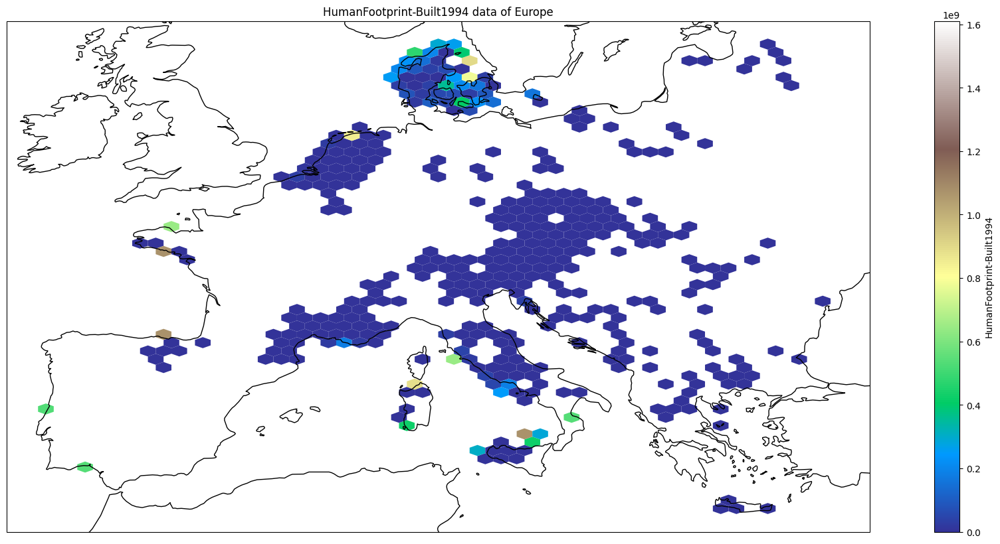

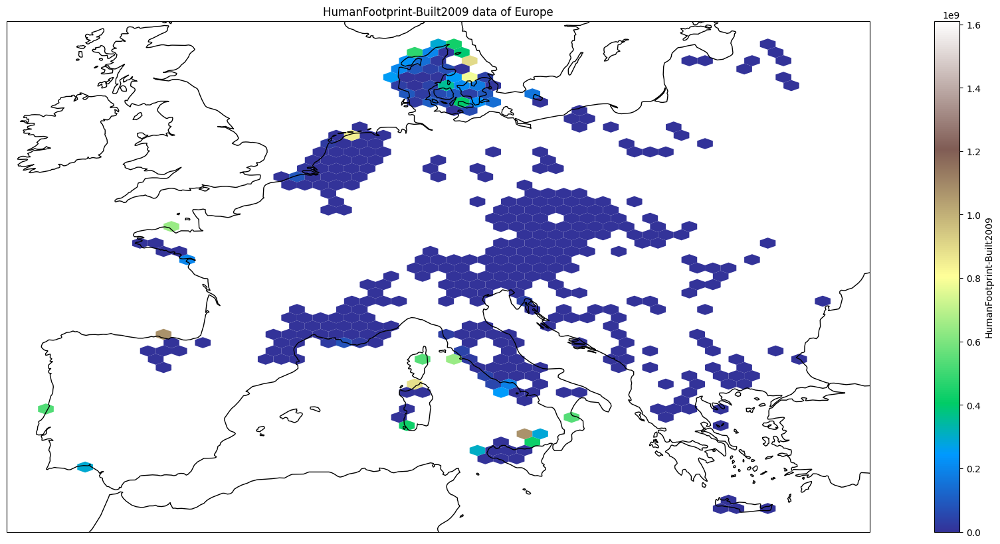

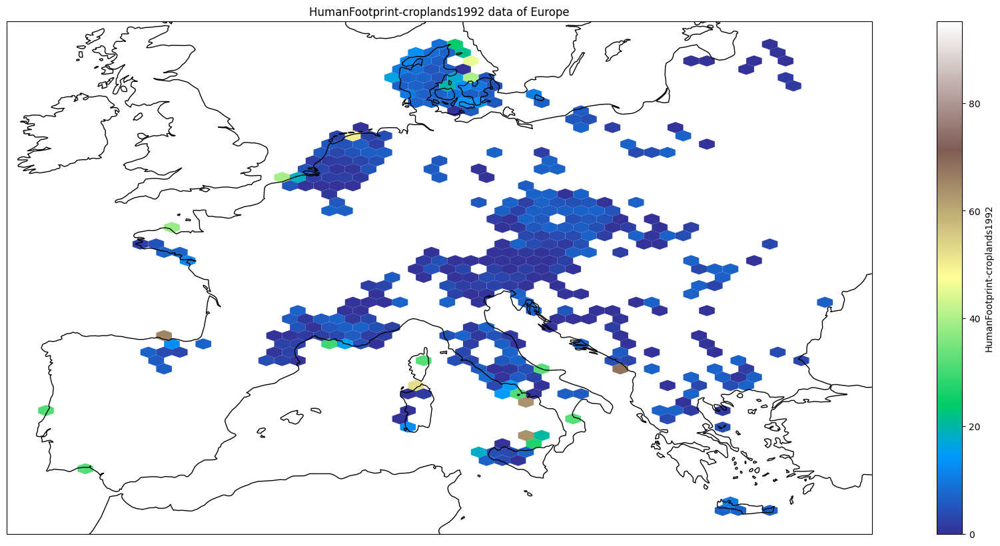

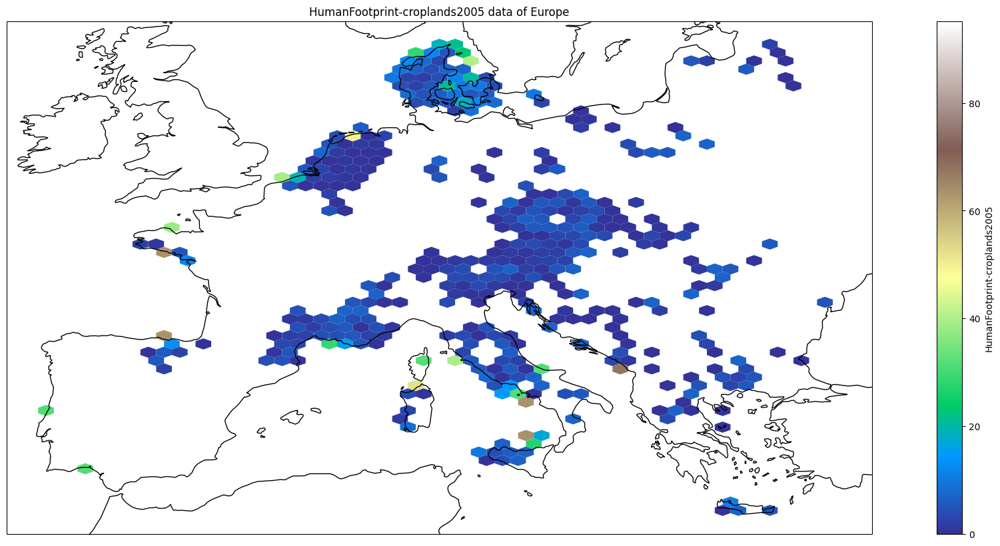

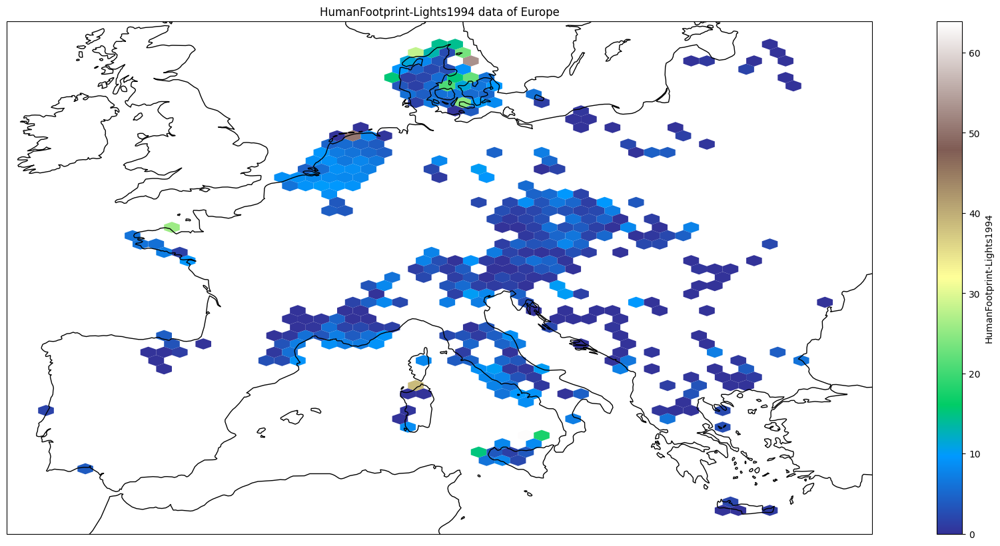

...

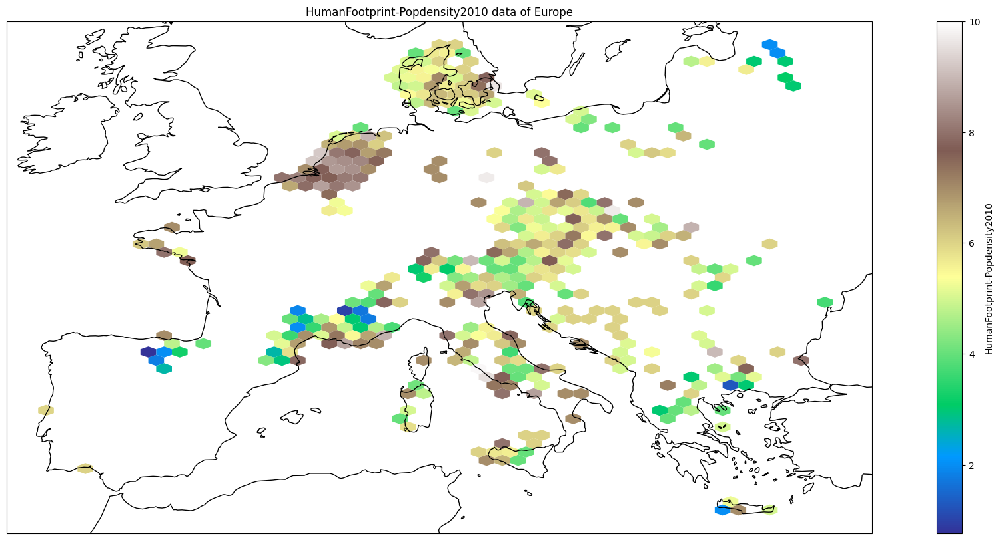

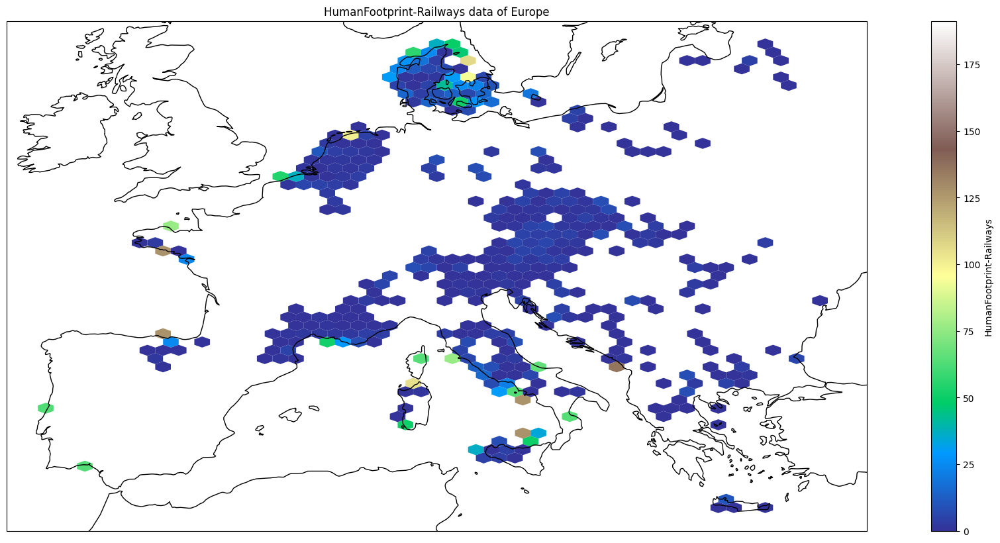

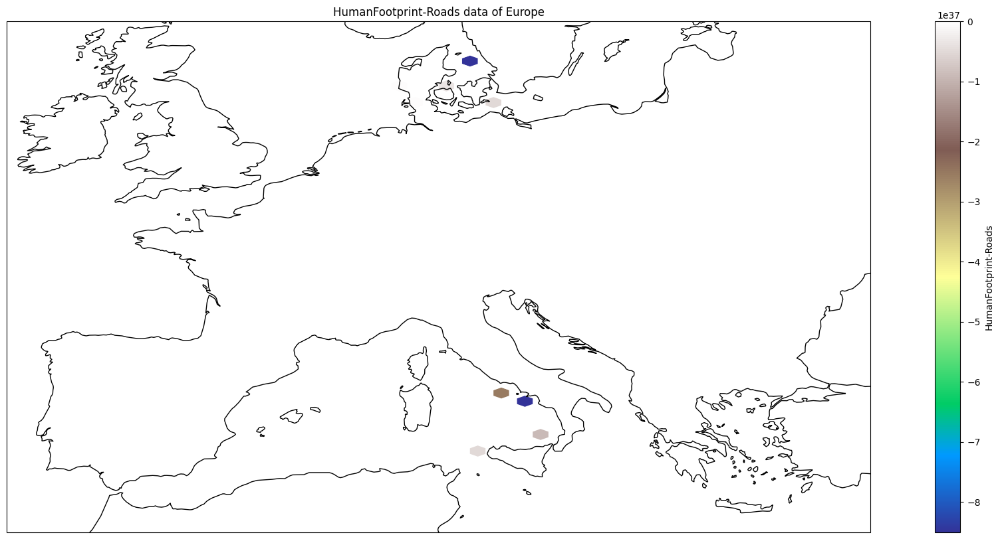

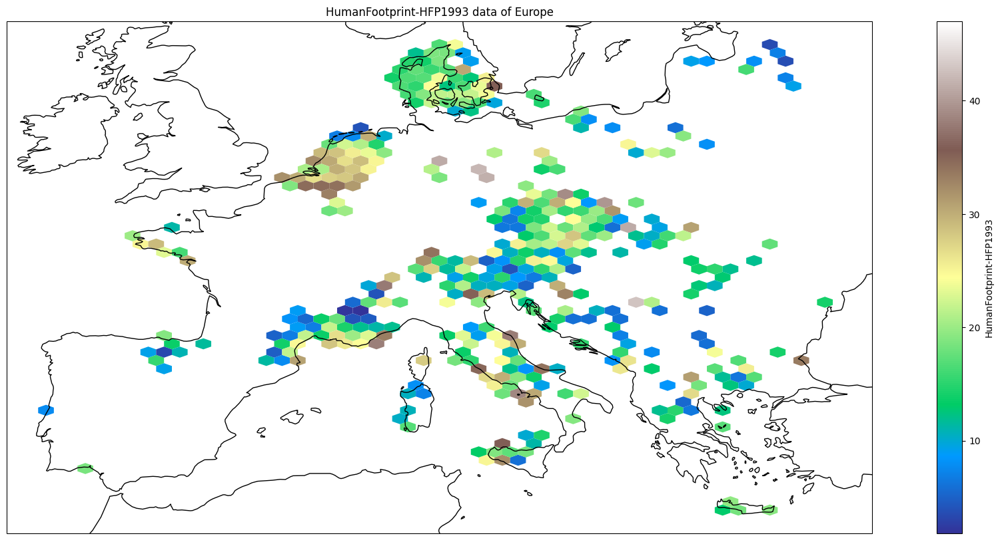

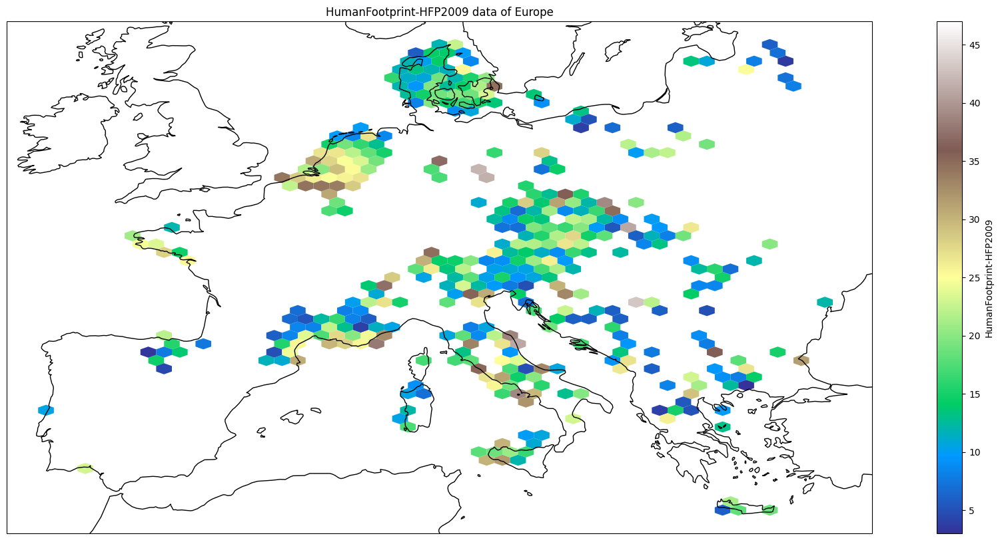

In [30]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt

footprintgrid_data = footprint_data.merge(data_coord, on='surveyId', how='left')

columns_to_plot = [col for col in footprintgrid_data.columns if col not in ['surveyId','lat', 'lon']]
for x in columns_to_plot:
    fig = plt.figure(figsize=(25, 10))
    
    # Extract latitude, longitude, and elevation columns
    latitude = footprintgrid_data['lat']
    longitude = footprintgrid_data['lon']
    footprint = footprintgrid_data[x]
    
    # Create a figure and axes with a PlateCarree projection
    ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree())

    # Add a background map of Europe
    ax.coastlines()

    # Create a 2D hexagonal binning plot (heatmap)
    hb = ax.hexbin(longitude, latitude, C=footprint, gridsize=50, cmap='terrain', edgecolors='none')

    # Add a colorbar
    cb = fig.colorbar(hb, ax=ax, orientation='vertical', label=x)

    # Add labels and title
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'{x} data of Europe')

    # Show the plot
    plt.show()

In [31]:
soil_data = pd.read_csv('Dataset/geolifeclef-2024/EnvironmentalRasters/EnvironmentalRasters/SoilGrids/GLC24-PA-train-soilgrids.csv')
soil_data.dropna(inplace=True)

soil_data

,surveyId,Soilgrid-bdod,Soilgrid-cec,Soilgrid-cfvo,Soilgrid-clay,Soilgrid-nitrogen,Soilgrid-phh2o,Soilgrid-sand,Soilgrid-silt,Soilgrid-soc
0,212,140.0,214.0,151.0,292.0,159.0,73.0,284.0,422.0,176.0
1,222,120.0,225.0,101.0,94.0,379.0,58.0,650.0,255.0,609.0
2,243,115.0,261.0,86.0,131.0,373.0,54.0,750.0,117.0,672.0
3,324,118.0,179.0,117.0,225.0,230.0,57.0,238.0,535.0,302.0
4,333,138.0,233.0,176.0,328.0,250.0,71.0,231.0,439.0,257.0
...,...,...,...,...,...,...,...,...,...,...
88982,3919553,116.0,199.0,65.0,116.0,311.0,59.0,622.0,260.0,485.0
88983,3919592,118.0,245.0,113.0,156.0,405.0,54.0,555.0,288.0,868.0
88984,3919620,113.0,233.0,70.0,71.0,253.0,56.0,798.0,129.0,414.0
88985,3919640,130.0,162.0,99.0,55.0,234.0,50.0,803.0,141.0,502.0


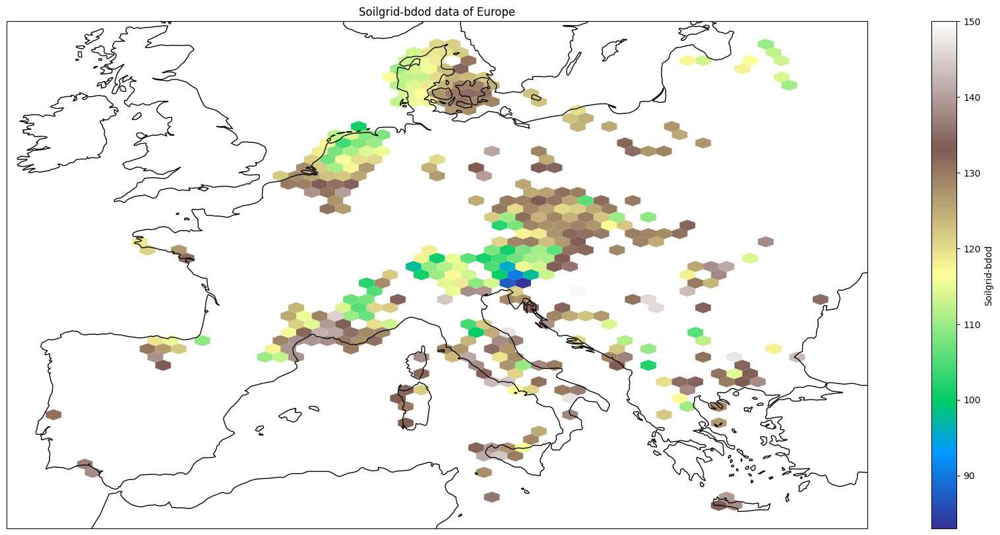

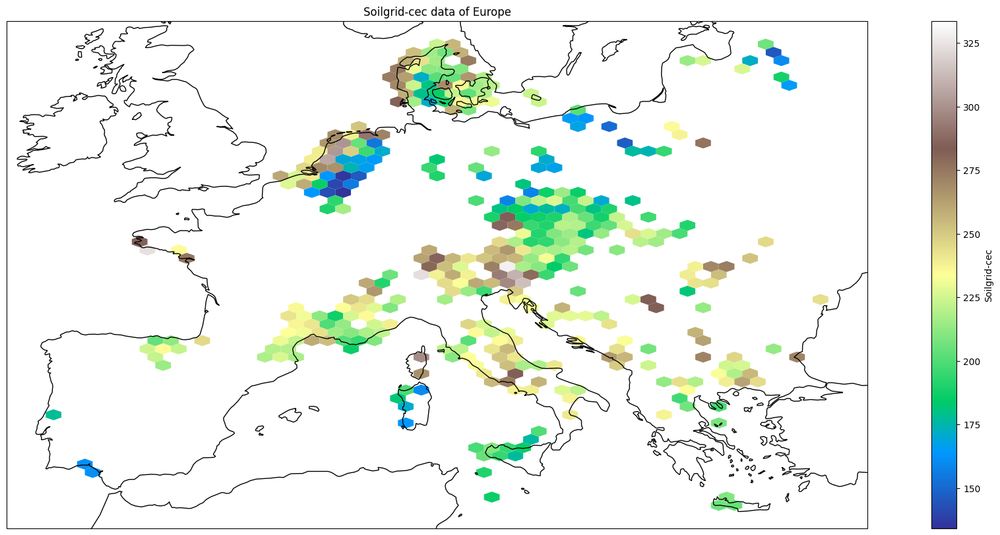

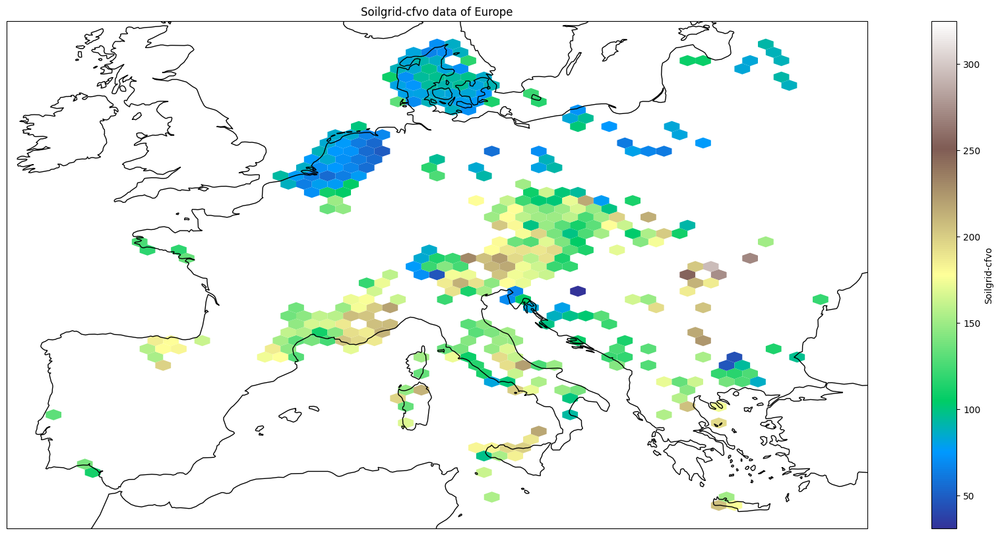

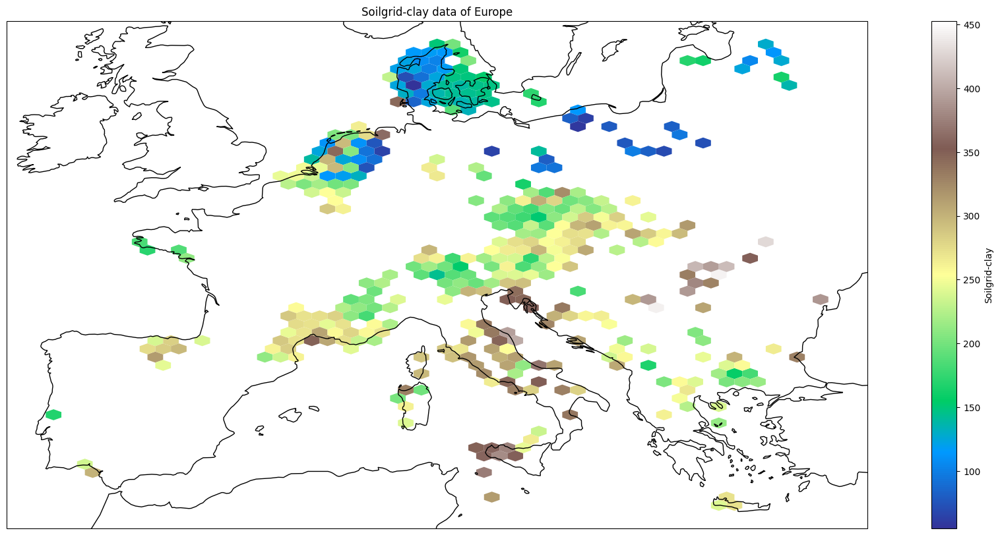

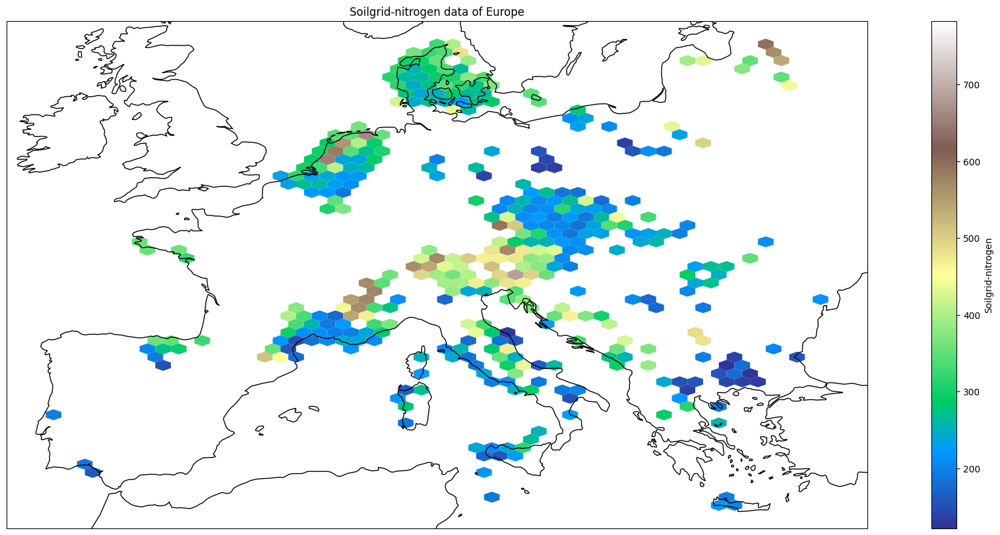

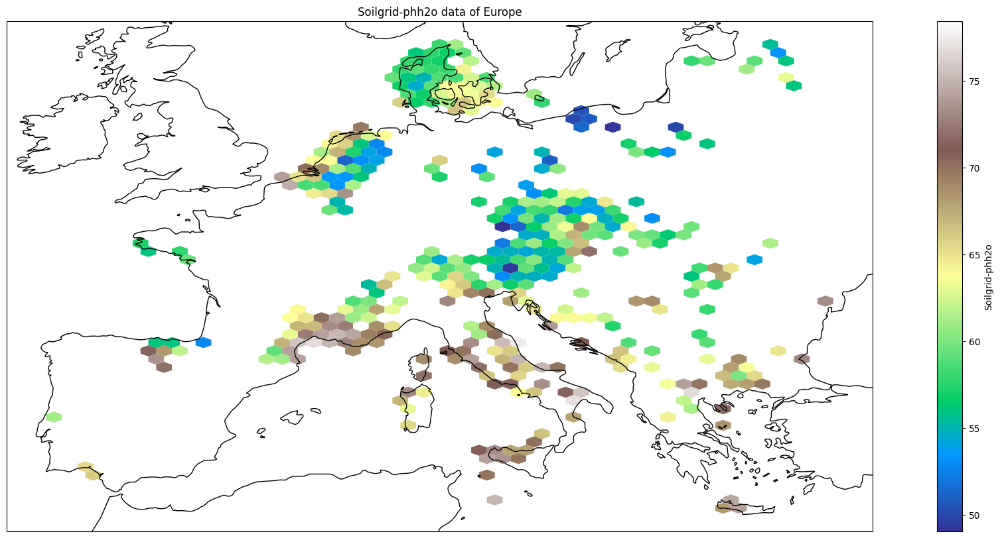

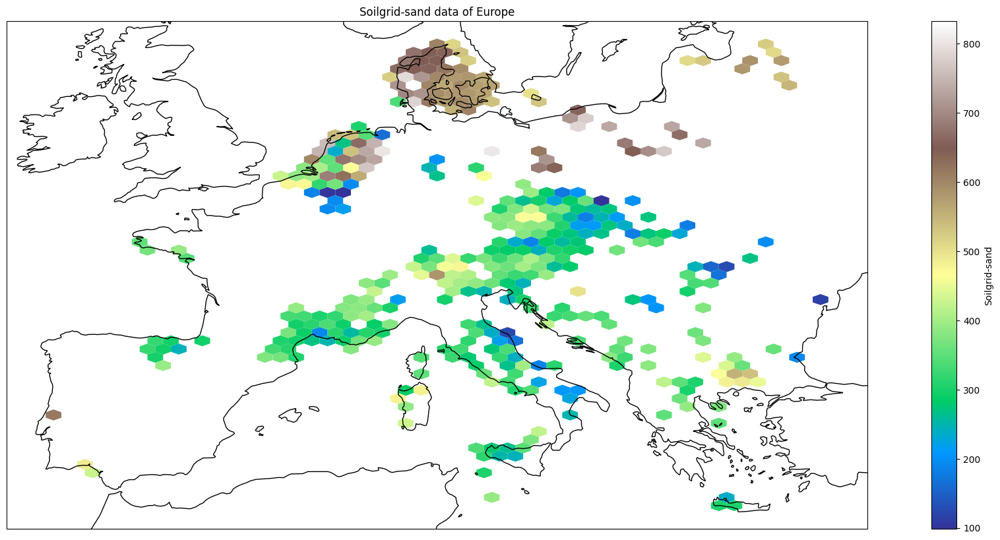

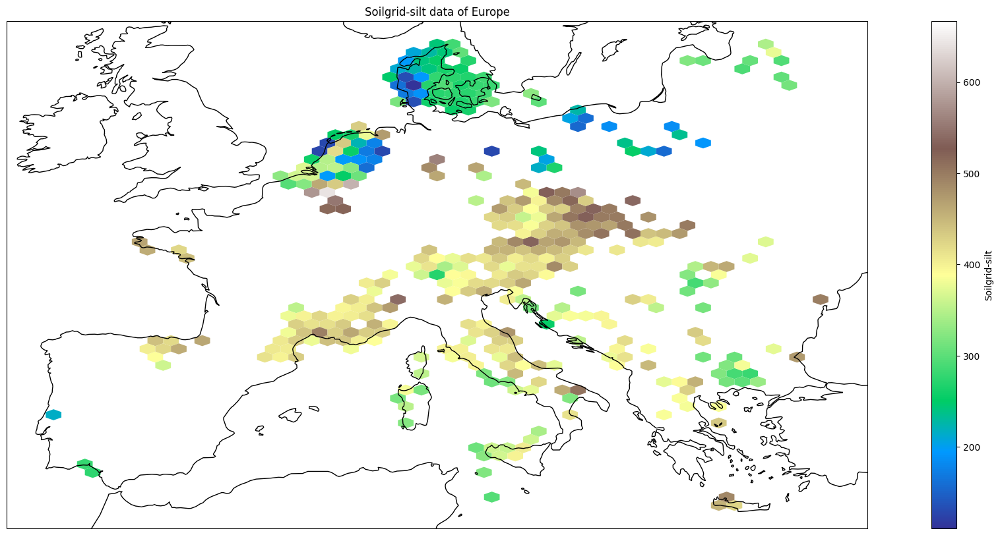

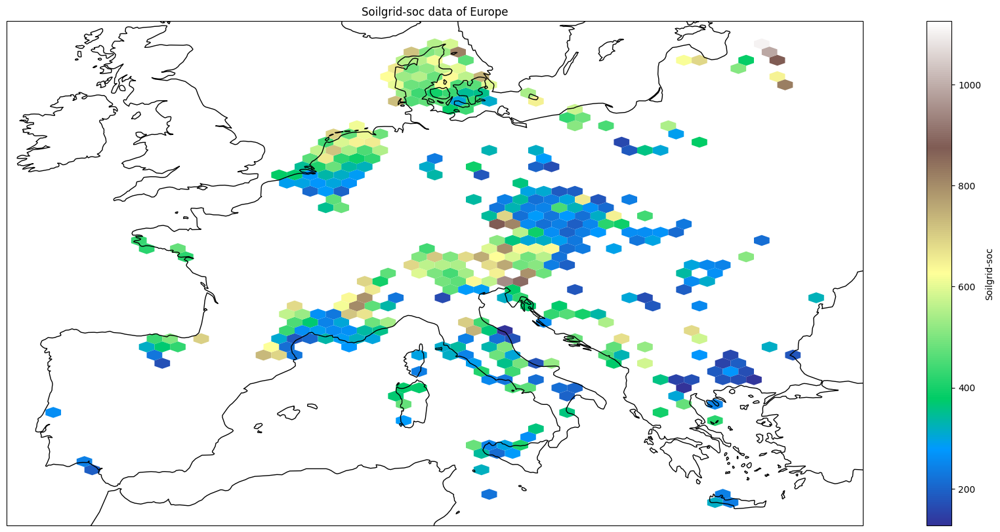

In [32]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt

soilgrid_data = soil_data.merge(data_coord, on='surveyId', how='left')

columns_to_plot = [col for col in soilgrid_data.columns if col not in ['surveyId','lat', 'lon']]
for x in columns_to_plot:
    fig = plt.figure(figsize=(25, 10))
    
    # Extract latitude, longitude, and elevation columns
    latitude = soilgrid_data['lat']
    longitude = soilgrid_data['lon']
    soildgrid = soilgrid_data[x]
    
    # Create a figure and axes with a PlateCarree projection
    ax = fig.add_subplot(1,1,1,projection=ccrs.PlateCarree())

    # Add a background map of Europe
    ax.coastlines()

    # Create a 2D hexagonal binning plot (heatmap)
    hb = ax.hexbin(longitude, latitude, C=soildgrid, gridsize=50, cmap='terrain', edgecolors='none')

    # Add a colorbar
    cb = fig.colorbar(hb, ax=ax, orientation='vertical', label=x)

    # Add labels and title
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_title(f'{x} data of Europe')

    # Show the plot
    plt.show()

MAKING THE PREDICTIONS

In [33]:
X = data_train.drop(["speciesId"],axis=1)
y = data_train["speciesId"].values.reshape(len(X),1)

In [34]:
from sklearn.datasets import make_multilabel_classification
from sklearn.multioutput import MultiOutputClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


X_train, X_test, y_train, y_test = train_test_split(X[:10000], y[:10000], test_size=0.2, random_state=42)

classifier = RandomForestClassifier(n_estimators=100, random_state=42)

multi_target_classifier = MultiOutputClassifier(classifier, n_jobs=-1)

multi_target_classifier.fit(X_train, y_train)

predictions = multi_target_classifier.predict(X_test)

# Evaluate accuracy
accuracy = accuracy_score(y_test, predictions)
print("Accuracy:", accuracy)

Accuracy: 0.0015
